# Libraries

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import torch
torch.cuda.empty_cache()

In [3]:
!pip install wandb
import wandb
import os
os.environ['WANDB_API_KEY'] = ''

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.9 MB 35.3 MB/s 
     |████████████████████████████████| 174 kB 75.6 MB/s 
     |████████████████████████████████| 182 kB 70.7 MB/s 
     |████████████████████████████████| 62 kB 1.6 MB/s 
     |████████████████████████████████| 173 kB 64.9 MB/s 
     |████████████████████████████████| 168 kB 74.7 MB/s 
     |████████████████████████████████| 168 kB 73.6 MB/s 
     |████████████████████████████████| 166 kB 77.6 MB/s 
     |████████████████████████████████| 166 kB 75.8 MB/s 
     |████████████████████████████████| 162 kB 75.5 MB/s 
     |████████████████████████████████| 162 kB 55.5 MB/s 
     |████████████████████████████████| 158 kB 67.2 MB/s 
     |████████████████████████████████| 157 kB 76.6 MB/s 
     |████████████████████████████████| 157 kB 72.9 MB/s 
     |████████████████████████████████| 157 kB 67.8 MB/s 
     |███████████████████████████

In [4]:
# Libraries
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import json
from sklearn import preprocessing
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import accuracy_score


In [5]:
# Ignore excessive warnings
import logging
logging.propagate = False 
logging.getLogger().setLevel(logging.ERROR)

In [6]:
%%capture
!pip install transformers

In [7]:
import torch
#from transformers.file_utils import is_tf_available, is_torch_available, is_torch_tpu_available
from transformers import BertTokenizerFast, BertForSequenceClassification
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification
from transformers import AutoTokenizer
from transformers import AutoModelForSequenceClassification, TrainingArguments, Trainer
from transformers import Trainer, TrainingArguments
import numpy as np
import random
from sklearn.datasets import fetch_20newsgroups
from sklearn.model_selection import train_test_split

# Data

In [8]:
# Data 
path_train = '/content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/train.csv'
path_valid = '/content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/valid.csv'
path_test = '/content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/test.csv'

df_train = pd.read_csv(path_train)
df_valid = pd.read_csv(path_valid)
df_test= pd.read_csv(path_test)
df_train.head()

,is_sarcastic,headline,article_link,lenght
0,1,thirtysomething scientists unveil doomsday clo...,https://www.theonion.com/thirtysomething-scien...,8
1,0,dem rep. totally nails why congress is falling...,https://www.huffingtonpost.com/entry/donna-edw...,13
2,0,eat your veggies: 9 deliciously different recipes,https://www.huffingtonpost.com/entry/eat-your-...,7
3,1,mother comes pretty close to using word 'strea...,https://www.theonion.com/mother-comes-pretty-c...,9
4,0,my white inheritance,https://www.huffingtonpost.com/entry/my-white-...,3


In [9]:
X_train = df_train['headline']
X_valid = df_valid['headline']
X_test = df_test['headline']

y_train = df_train['is_sarcastic']
y_valid = df_valid['is_sarcastic']
y_test = df_test['is_sarcastic']

In [10]:
target_names = list(df_train['is_sarcastic'].unique())
target_names

[1, 0]

In [11]:
X_train[0]

'thirtysomething scientists unveil doomsday clock of hair loss'

In [12]:
y_train.dtype

dtype('int64')

In [13]:
df_test.iloc[2]['headline'] # not ironic


'saudi courts should exhibit independence by protecting speech'

In [14]:
df_test.iloc[5]['headline'] # not ironic

'violence erupts ahead of u.s. embassy opening in jerusalem'

In [15]:
df_test.iloc[1887]['headline'] # ironic

'bitchy girlfriend just asking for anne hathaway to swoop in, steal man away'

In [16]:
df_test.iloc[1886]['headline'] # ironic

"sighing trump sexual assault accusers announce they'll try coming forward again next week"

In [17]:
df_test_check = df_test[df_test['is_sarcastic'] == 0]
df_test_check

,is_sarcastic,headline,article_link,lenght
1,0,"beyoncé, me and the hbcu i should have gone to",https://www.huffingtonpost.com/entry/beyonce-h...,10
2,0,saudi courts should exhibit independence by pr...,https://www.huffingtonpost.com/entry/saudi-cou...,8
3,0,billy eichner boogied with obama and ellen got...,https://www.huffingtonpost.com/entry/billy-eic...,11
5,0,violence erupts ahead of u.s. embassy opening ...,https://www.huffingtonpost.com/entry/the-morni...,9
6,0,man missing after explosion was saving up to r...,https://www.huffingtonpost.com/entry/moises-lo...,12
...,...,...,...,...
1872,0,florida man who landed gyrocopter at u.s. capi...,https://www.huffingtonpost.com/entry/gyrocopte...,11
1875,0,the one thing that really was better when we w...,https://www.huffingtonpost.com/entry/one-thing...,11
1877,0,mindful mantras for teachers,https://www.huffingtonpost.com/entry/mindful-m...,4
1883,0,8 things students with chronic stomach problem...,https://www.huffingtonpost.com/entry/8-things-...,8


# Transformer training (fine-tuning)
- Bert


In [ ]:
# Track experiement on WandB (MLOps)
wandb.init(project="dtu_deepl_models", 
           entity='lucialarraona',
           name= "bert-base-1",
           tags=["3epoch", "best-run"],
           group="FINAL-BERT-POSTER")

wandb: Currently logged in as: lucialarraona. Use `wandb login --relogin` to force relogin


####  Define model and max_length

In [ ]:
# Define model-name (based on hugging-face library)
# We are trying 2, bert and distilledbert

model_name = "bert-base-uncased"
#model_name = 'distilbert-base-uncased'

# max sequence length for each document/sentence sample (headlines are much shorter, we'll change it)
max_length = 200

#### Preprocessing

In [ ]:
# Hugging Face has its own tokenizer for the transformer: Load the tokenizer

# A different tokenizer for each
tokenizer = BertTokenizerFast.from_pretrained(model_name, do_lower_case=True)
#tokenizer = DistilBertTokenizer.from_pretrained(model_name, do_lower_case = True)

Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/570 [00:00<?, ?B/s]

In [ ]:
# tokenize the dataset, truncate when passed `max_length`, and pad with 0's when less than `max_length`
train_encodings = tokenizer(df_train.headline.values.tolist(), 
      add_special_tokens=True,
      truncation=True,
      max_length=max_length,
      return_token_type_ids=False,
      padding=True,
      return_attention_mask=True,
      return_tensors='pt')

valid_encodings = tokenizer(df_valid.headline.values.tolist(), 
      add_special_tokens=True,
      truncation=True,
      max_length=max_length,
      return_token_type_ids=False,
      padding=True,
      return_attention_mask=True,
      return_tensors='pt')


test_encodings = tokenizer(df_test.headline.values.tolist(),
      add_special_tokens=True,
      truncation=True,
      max_length=max_length,
      return_token_type_ids=False,
      padding=True,
      return_attention_mask=True,
      return_tensors='pt')

In [ ]:
# Create a new dataset with the tokenized input(headlines) and the labels
class NewsHeadlinesDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __getitem__(self, idx):
        item = {k: torch.tensor(v[idx]) for k, v in self.encodings.items()}
        item["labels"] = torch.tensor([self.labels[idx]])
        return item

    def __len__(self):
        return len(self.labels)


# convert our tokenized data into a torch Dataset
train_dataset = NewsHeadlinesDataset(train_encodings, torch.from_numpy(y_train.values))
valid_dataset = NewsHeadlinesDataset(valid_encodings, torch.from_numpy(y_valid.values))
test_dataset = NewsHeadlinesDataset(test_encodings, torch.from_numpy(y_test.values))

### Train

In [ ]:
# Training with Trainer function from HuggingFace
# Load the model and pass to CUDA
model = BertForSequenceClassification.from_pretrained(model_name,# Use the 12-layer BERT model, with an uncased vocab.
                                                      num_labels = 2, # The number of output labels--2 for binary classification.  si pones num_labels=1 hace MSE LOSS
                                                      output_attentions = True, # Whether the model returns attentions weights. True, for future visualization
                                                      output_hidden_states = False ,# Whether the model returns all hidden-states.   
                                                      vocab_size=tokenizer.vocab_size)

Downloading:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.transform.LayerNorm.bias', 'cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model checkpoint at

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)
print(device)

cuda:0


In [ ]:
# Define metrics for evaluating the classification model and pass it to the Trainer object
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    precision, recall, f1, _ = precision_recall_fscore_support(labels, preds, average='weighted')
    acc = accuracy_score(labels, preds)
    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }

In [ ]:
training_args = TrainingArguments(
    output_dir='./results',          # output directory
    overwrite_output_dir = True,
    num_train_epochs=3,              # total number of training epochs
    evaluation_strategy="epoch",
    save_strategy = 'epoch',
    per_device_train_batch_size=32,   # batch size per device during training
    per_device_eval_batch_size=64,   # batch size for evaluation
    learning_rate = 5e-5,
    warmup_steps=500,                # number of warmup steps for learning rate scheduler
    weight_decay=0.01,               # strength of weight decay
    logging_dir='./logs',            # directory for storing logs
    load_best_model_at_end=True,     # load the best model when finished training (default metric is loss)
    metric_for_best_model = 'accuracy',
                                        
                                        # but you can specify `metric_for_best_model` argument to change to accuracy or other metric
    logging_steps=400,               # log & save weights each logging_steps
    save_steps=400,
    report_to="wandb"                # report to WANDB to keep track of the metrics :) 
)

trainer = Trainer(
    model=model,                         # the instantiated Transformers model to be trained
    args=training_args,                  # training arguments, defined above
    train_dataset=train_dataset,         # training dataset
    eval_dataset=valid_dataset,           # evaluation dataset
    compute_metrics=compute_metrics,     # the callback that computes metrics of interest
)


trainer.train()

In [ ]:
wandb.finish()

In [ ]:
# Save the best model (trained already) and the tokenizer 
# model_path = "/content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/saved_models"
#trainer.save_model(model_path)
#model.save_pretrained(model_path)
#tokenizer.save_pretrained(model_path)

# Transformer Evaluation

- Model saved after training so we are not running the previous loop, just loading the model and preprocessing the text data again from tha saved tokenizer etc. 


In [18]:
torch.cuda.empty_cache() # for better performance

In [19]:
# Load best model saved before for further evaluation

model_path= '/content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/model_transformer_saved_best'

max_length = 200

tokenizer = BertTokenizerFast.from_pretrained(model_path, do_lower_case=True)

model = BertForSequenceClassification.from_pretrained(model_path,# Use the 12-layer BERT model, with an uncased vocab.
                                                      num_labels = 2, # The number of output labels--2 for binary classification.  si pones num_labels=1 hace MSE LOSS
                                                      output_attentions = False, # Whether the model returns attentions weights. True, for future visualization
                                                      output_hidden_states = False ,# Whether the model returns all hidden-states.   
                                                      vocab_size=tokenizer.vocab_size)



# tokenize the dataset, truncate when passed `max_length`, and pad with 0's when less than `max_length`
train_encodings = tokenizer(df_train.headline.values.tolist(), 
      add_special_tokens=True,
      truncation=True,
      max_length=max_length,
      return_token_type_ids=False,
      padding=True,
      return_attention_mask=True,
      return_tensors='pt')

valid_encodings = tokenizer(df_valid.headline.values.tolist(), 
      add_special_tokens=True,
      truncation=True,
      max_length=max_length,
      return_token_type_ids=False,
      padding=True,
      return_attention_mask=True,
      return_tensors='pt')


test_encodings = tokenizer(df_test.headline.values.tolist(),
      add_special_tokens=True,
      truncation=True,
      max_length=max_length,
      return_token_type_ids=False,
      padding=True,
      return_attention_mask=True,
      return_tensors='pt')


# Create a new dataset with the tokenized input(headlines) and the labels
class NewsHeadlinesDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __getitem__(self, idx):
        item = {k: torch.tensor(v[idx]) for k, v in self.encodings.items()}
        item["labels"] = torch.tensor([self.labels[idx]])
        return item

    def __len__(self):
        return len(self.labels)


# convert our tokenized data into a torch Dataset
train_dataset = NewsHeadlinesDataset(train_encodings, torch.from_numpy(y_train.values))
valid_dataset = NewsHeadlinesDataset(valid_encodings, torch.from_numpy(y_valid.values))
test_dataset = NewsHeadlinesDataset(test_encodings, torch.from_numpy(y_test.values))


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)
print(device)

# Define metrics for evaluating the classification model and pass it to the Trainer object
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score

def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    precision, recall, f1, _ = precision_recall_fscore_support(labels, preds, average='weighted')
    acc = accuracy_score(labels, preds)
    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall
    }

training_args = TrainingArguments(
    output_dir='./results',          # output directory
    overwrite_output_dir = True,
    num_train_epochs=3,              # total number of training epochs
    evaluation_strategy="epoch",
    save_strategy = 'epoch',
    per_device_train_batch_size=32,   # batch size per device during training
    per_device_eval_batch_size=64,   # batch size for evaluation
    learning_rate = 5e-5,
    warmup_steps=500,                # number of warmup steps for learning rate scheduler
    weight_decay=0.01,               # strength of weight decay
    logging_dir='./logs',            # directory for storing logs
    load_best_model_at_end=True,     # load the best model when finished training (default metric is loss)
    metric_for_best_model = 'accuracy',
                                        
                                        # but you can specify `metric_for_best_model` argument to change to accuracy or other metric
    logging_steps=400,               # log & save weights each logging_steps
    save_steps=400,
    #report_to="wandb"                # report to WANDB to keep track of the metrics :) 
)

trainer = Trainer(
    model=model,                         # the instantiated Transformers model to be trained
    args=training_args,                  # training arguments, defined above
    train_dataset=train_dataset,         # training dataset
    eval_dataset=valid_dataset,           # evaluation dataset
    compute_metrics=compute_metrics,     # the callback that computes metrics of interest
)



cuda:0


In [20]:
# Evaluate the model after training
trainer.evaluate()

***** Running Evaluation *****
  Num examples = 7555
  Batch size = 64
<ipython-input-19-ef442ab28209>:54: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  item = {k: torch.tensor(v[idx]) for k, v in self.encodings.items()}


Automatic Weights & Biases logging enabled, to disable set os.environ["WANDB_DISABLED"] = "true"
wandb: Currently logged in as: lucialarraona (deep-sarcastic). Use `wandb login --relogin` to force relogin


{'eval_loss': 0.19931937754154205,
 'eval_accuracy': 0.9311714096624751,
 'eval_f1': 0.9311596234067664,
 'eval_precision': 0.9311699476486968,
 'eval_recall': 0.9311714096624751,
 'eval_runtime': 23.9293,
 'eval_samples_per_second': 315.722,
 'eval_steps_per_second': 4.973}

In [21]:
def get_prediction(text):
    # prepare our text into tokenized sequence
    inputs = tokenizer(text, padding=True, truncation=True, max_length=max_length, return_tensors="pt").to("cuda")
    # perform inference to our model
    outputs = model(**inputs)
    # get output probabilities by doing softmax
    probs = outputs[0].softmax(1)
    # executing argmax function to get the candidate label
    return target_names[probs.argmax()]

***** Running Prediction *****
  Num examples = 1889
  Batch size = 64
<ipython-input-19-ef442ab28209>:54: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  item = {k: torch.tensor(v[idx]) for k, v in self.encodings.items()}


              precision    recall  f1-score   support

           0       0.93      0.94      0.93      1006
           1       0.93      0.92      0.92       883

    accuracy                           0.93      1889
   macro avg       0.93      0.93      0.93      1889
weighted avg       0.93      0.93      0.93      1889

{'test_loss': 0.19454249739646912, 'test_accuracy': 0.9295923769190048, 'test_f1': 0.9295796906357818, 'test_precision': 0.9295800855470187, 'test_recall': 0.9295923769190048, 'test_runtime': 4.6415, 'test_samples_per_second': 406.981, 'test_steps_per_second': 6.463}


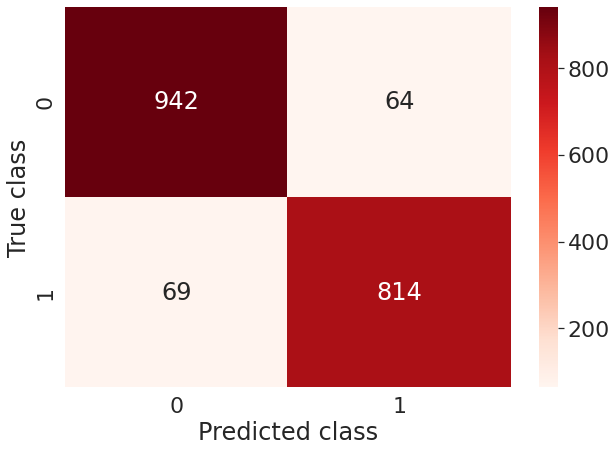

In [22]:
## Creating confusion matrix from predictions on the TEST set in order to compare to LSTM

from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report


predictions,labels, metrics = trainer.predict(test_dataset)  

# conf matrix
matrix = confusion_matrix(labels, predictions.argmax(axis=1))

plt.figure(figsize = (10,7))

## Confusion matrix with counts
sns.set(font_scale=2.0)
sns.heatmap(matrix, annot=True, cmap='Reds',fmt='g')

#sns.heatmap(matrix/np.sum(matrix), annot=True, 
#          fmt='.2%', cmap='Oranges')

plt.xlabel("Predicted class")
plt.ylabel("True class") 

clas_report = classification_report(labels, predictions.argmax(axis=1))

print(clas_report)
print(metrics)
None

In [23]:
#wandb.finish()

In [24]:
preds_binary = []
for i in predictions:
  preds_binary.append(i.argmax())

In [25]:
df_test['bert_prediction'] = preds_binary
df_test

,is_sarcastic,headline,article_link,lenght,bert_prediction
0,1,"'hold still,' says eric trump swinging sword a...",https://politics.theonion.com/hold-still-says-...,14,1
1,0,"beyoncé, me and the hbcu i should have gone to",https://www.huffingtonpost.com/entry/beyonce-h...,10,0
2,0,saudi courts should exhibit independence by pr...,https://www.huffingtonpost.com/entry/saudi-cou...,8,0
3,0,billy eichner boogied with obama and ellen got...,https://www.huffingtonpost.com/entry/billy-eic...,11,0
4,1,new yorkers cower as clinton victory speech re...,https://politics.theonion.com/new-yorkers-cowe...,11,1
...,...,...,...,...,...
1884,1,junior-high-school badminton unit inspires 948...,https://sports.theonion.com/junior-high-school...,7,1
1885,1,"frantic, last-second study finds old-fashioned...",https://www.theonion.com/frantic-last-second-s...,12,1
1886,1,sighing trump sexual assault accusers announce...,https://politics.theonion.com/sighing-trump-se...,13,1
1887,1,bitchy girlfriend just asking for anne hathawa...,https://entertainment.theonion.com/bitchy-girl...,13,1


In [ ]:
for index, row in df_test.iterrows():
    print(row['headline'], row['is_sarcastic'], row['bert_prediction'])

In [26]:
# Look for the examples where the prediction is wrong (true label != prediction)
df_test_misclassified = df_test[df_test.is_sarcastic != df_test.bert_prediction]
df_test_misclassified

,is_sarcastic,headline,article_link,lenght,bert_prediction
6,0,man missing after explosion was saving up to r...,https://www.huffingtonpost.com/entry/moises-lo...,12,1
13,1,4 out of 5 texas dentists advocate the death p...,https://www.theonion.com/4-out-of-5-texas-dent...,10,0
19,1,jonathan lipnicki to star as young 'dark helme...,https://entertainment.theonion.com/jonathan-li...,11,0
65,1,ugly custody battle over ian mckellen narrowly...,https://www.theonion.com/ugly-custody-battle-o...,8,0
67,1,bill cosby announces dates for u.s. college co...,https://www.theonion.com/bill-cosby-announces-...,9,0
...,...,...,...,...,...
1820,0,brad pitt goes completely gray for new movie,https://www.huffingtonpost.com/entry/brad-pitt...,8,1
1841,1,trump admits he assumed roger stone was alread...,https://politics.theonion.com/trump-admits-he-...,10,0
1842,0,pope francis captivated by teen cancer patient...,https://www.huffingtonpost.com/entry/pope-fran...,11,1
1866,0,cubs fans caught in time loop now that 'next y...,https://www.huffingtonpost.com/entry/cubs-fans...,14,1


In [27]:
print(f'The BERT transformer misclassified {df_test_misclassified.shape[0]} examples of the test set ')

The BERT transformer misclassified 133 examples of the test set 


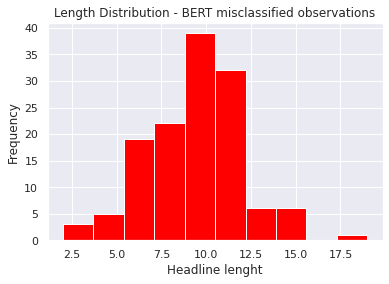

In [28]:
# Plot histogram of the lengths in the misclassified observation 
sns.set(font_scale=1.0)
hist1 = df_test_misclassified.lenght.plot.hist(bins=10, color ='red')
hist1
plt.title('Length Distribution - BERT misclassified observations')
plt.xlabel('Headline lenght')
None

In [29]:
df_test_misclassified.lenght.describe()

count    133.000000
mean       9.436090
std        2.574212
min        2.000000
25%        8.000000
50%       10.000000
75%       11.000000
max       19.000000
Name: lenght, dtype: float64

In [30]:
print(df_test.headline[1842])
print(f'True label: {labels[1842]}')
print(f'Prediction: {predictions[1842].argmax()}')

pope francis captivated by teen cancer patient's rendition of 'ave maria'
True label: [0]
Prediction: 1


In [31]:
print(df_test.headline[13])
print(f'True label: {labels[13]}')
print(f'Prediction: {predictions[13].argmax()}')

4 out of 5 texas dentists advocate the death penalty
True label: [1]
Prediction: 0


In [32]:
print(df_test.headline[1887])
#print(test_dataset[0])
print(f'True label: {labels[1887]}')
print(f'Prediction: {predictions[1887].argmax()}')

bitchy girlfriend just asking for anne hathaway to swoop in, steal man away
True label: [1]
Prediction: 1


In [33]:
print(df_test.headline[5])
#print(test_dataset[0])
print(f'True label: {labels[5]}')
print(f'Prediction: {predictions[5].argmax()}')

violence erupts ahead of u.s. embassy opening in jerusalem
True label: [0]
Prediction: 0


In [ ]:
for index, row in df_test_misclassified.iterrows():
    print(row['headline'], row['is_sarcastic'], row['bert_prediction'])

### Comparing to LSTM results 


In [35]:
df_results_lstm = pd.read_csv('/content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/df_result9.csv')
df_results_lstm['predictions'] = df_results_lstm['predictions'].astype(int)
df_results_lstm['label'] = df_results_lstm['label'].astype(int)
print(df_results_lstm.shape)
df_results_lstm.head()

# COMMENT: for some reason converting from indices to tokens in the loop gives the text of 
# the headline alltogether and not with the white spaces :(

(1889, 4)


,text,text_length,label,predictions
0,<unk>and<unk>issuescommemorativeleonardodicapr...,11,1,0
1,houseflydropseverythingtogostandonwatermelonslice,11,1,1
2,<unk>laid-backdoctorrefersto<unk>as'the<unk>,11,1,1
3,thingscomeapartso<unk>asghar<unk>about<unk>,11,0,0
4,'justanotherlingering<unk>bydr.david<unk><unk>,11,0,0


In [ ]:
# Look for the examples where the prediction is wrong (true label != prediction)
df_test_misclassified_lstm= df_results_lstm[df_results_lstm.label != df_results_lstm.predictions]
print(f'The Bi-LSTM model missclasified {df_test_misclassified_lstm.shape[0]} examples of the test set')
for index, row in df_test_misclassified_lstm.iterrows():
    print(row['text'], row['label'], row['predictions'])

# gotta look for the examples with control F in this case 

The Bi-LSTM model missclasified 278 examples of the test set
<unk>and<unk>issuescommemorativeleonardodicaprio<unk>stamp 1 0
compassionatetrumpissuesfullpresidentialpardonforrobertmueller 1 0
mikepence<unk><unk>over<unk>ladyjusticestatue 1 0
egyptsendssubmarinetolookformissingflight<unk> 0 1
<unk>obamasstronglypushingmaliatoward<unk>communitycollege 1 0
fatkidjustwantstowatchyouguysplay 1 0
iraq'sprimeministerunveilsplantotrimcriticizedgovernment 0 1
scientistsidentifypossiblecauseofhugeiceshelfcollapse 0 1
manshootsupbathroomwhen<unk>takestoolong,policesay 0 1
manaccusedofkillingdadfornotgettinghimfastfood 0 1
jerrysanduskyhopingjudgetakesiteasyonhimwithsentencing 1 0
incrediblydaringman<unk>tohawaii'slavawithaselfiestick 0 1
teaparty<unk>promisetospendonelectingcandidatesfallsflat 0 1
5millionillegalimmigrantstorealizedreamsofhavingdeportation<unk> 1 0
popefranciscaptivatedbyteencancerpatient's<unk>of<unk><unk> 0 1
backgroundchecksforgunsaleshitrecordhighonblackfriday 0 1
<unk>from'th

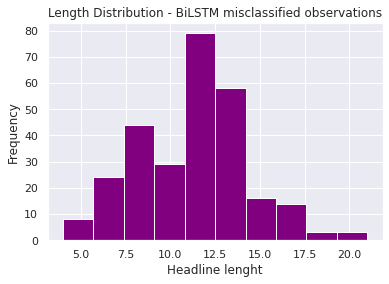

In [ ]:
# Plot histogram of the lengths in the misclassified observations
sns.set(font_scale=1.0)
hist1 = df_test_misclassified_lstm.text_length.plot.hist(bins=10,color = 'purple')
hist1
plt.title('Length Distribution - BiLSTM misclassified observations')
plt.xlabel('Headline lenght')
None

In [ ]:
df_test_misclassified_lstm.text_length.describe()

count    278.000000
mean      11.284173
std        3.026090
min        4.000000
25%        9.000000
50%       12.000000
75%       13.000000
max       21.000000
Name: text_length, dtype: float64

In [ ]:
# classified as not ironic, but IS ironic
df_results_lstm.query('label  == 1 & predictions == 0')

,text,text_length,label,predictions
0,<unk>and<unk>issuescommemorativeleonardodicapr...,11,1,0
9,compassionatetrumpissuesfullpresidentialpardon...,11,1,0
14,mikepence<unk><unk>over<unk>ladyjusticestatue,11,1,0
19,<unk>obamasstronglypushingmaliatoward<unk>comm...,11,1,0
25,fatkidjustwantstowatchyouguysplay,11,1,0
...,...,...,...,...
1834,hypotheticalcatsimultaneouslydeadand<unk>physi...,10,1,0
1852,banksintroduce<unk><unk>forusingword<unk>,10,1,0
1854,uglycustodybattleoverianmckellennarrowlyavoided,10,1,0
1878,<unk>mayornow<unk><unk>republicanofficial,9,1,0


In [ ]:
# classified as ironic, but is NOT ironic
df_results_lstm.query('label  == 0 & predictions == 1')

,text,text_length,label,predictions
18,egyptsendssubmarinetolookformissingflight<unk>,11,0,1
27,iraq'sprimeministerunveilsplantotrimcriticized...,11,0,1
31,scientistsidentifypossiblecauseofhugeiceshelfc...,11,0,1
34,"manshootsupbathroomwhen<unk>takestoolong,polic...",13,0,1
39,manaccusedofkillingdadfornotgettinghimfastfood,13,0,1
...,...,...,...,...
1809,<unk>recallsmillionsoffrozenproductsthatmaycon...,12,0,1
1822,taylorswiftshares'family<unk>withlotsoffamousl...,12,0,1
1843,<unk>oldshotbyfathercleaningillegalgun,10,0,1
1855,studentconstructsweddingdressoutofdivorcepapers,10,0,1


# Visualizing attention from bert 

- See this article for reference 
https://towardsdatascience.com/deconstructing-bert-part-2-visualizing-the-inner-workings-of-attention-60a16d86b5c1


In [35]:
%%capture 
!pip install bertviz

In [36]:
from bertviz import head_view, model_view
from transformers import BertTokenizer, BertModel
from transformers import BertTokenizerFast, BertForSequenceClassification

# We used our pretrained and saved model 
#model_version = 'bert-base-uncased'
model_version = '/content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/model_transformer_saved_best'
model = BertForSequenceClassification.from_pretrained(model_version, output_attentions=True) # important to ouput attentions in order to visualize it 
tokenizer = BertTokenizerFast.from_pretrained(model_version)

# Select two sentences from the test set and tokenize and encode 

#sentence_a = "The cat sat on the mat"
#sentence_b = "The cat lay on the rug"

sentence_a = X_test[1842] # not ironic missclassified as ironic
sentence_b = X_test[13] # ironic missclassified as not ironic

print(sentence_a)
print(sentence_b)

inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt')
input_ids = inputs['input_ids']
token_type_ids = inputs['token_type_ids']

attention = model(input_ids, token_type_ids=token_type_ids)[-1]

sentence_b_start = token_type_ids[0].tolist().index(1)

input_id_list = input_ids[0].tolist() # Batch index 0

tokens = tokenizer.convert_ids_to_tokens(input_id_list) 

loading configuration file /content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/model_transformer_saved_best/config.json
Model config BertConfig {
  "_name_or_path": "bert-base-uncased",
  "architectures": [
    "BertForSequenceClassification"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "output_attentions": true,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "problem_type": "single_label_classification",
  "torch_dtype": "float32",
  "transformers_version": "4.25.1",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading weights file /content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/model_transformer_sa

pope francis captivated by teen cancer patient's rendition of 'ave maria'
4 out of 5 texas dentists advocate the death penalty


## Head View
<b>The head view visualizes attention in one or more heads from a single Transformer layer.</b> Each line shows the attention from one token (left) to another (right). Line weight reflects the attention value (ranges from 0 to 1), while line color identifies the attention head. When multiple heads are selected (indicated by the colored tiles at the top), the corresponding  visualizations are overlaid onto one another.  For a more detailed explanation of attention in Transformer models, please refer to the [blog](https://towardsdatascience.com/deconstructing-bert-part-2-visualizing-the-inner-workings-of-attention-60a16d86b5c1).

## Usage
👉 **Hover** over any **token** on the left/right side of the visualization to filter attention from/to that token. <br/>
👉 **Double-click** on any of the **colored tiles** at the top to filter to the corresponding attention head.<br/>
👉 **Single-click** on any of the **colored tiles** to toggle selection of the corresponding attention head. <br/>
👉 **Click** on the **Layer** drop-down to change the model layer (zero-indexed).

In [37]:
head_view(attention, tokens, sentence_b_start)

<IPython.core.display.Javascript object>

## Model View
<b>The model view provides a birds-eye view of attention throughout the entire model</b>. Each cell shows the attention weights for a particular head, indexed by layer (row) and head (column).  The lines in each cell represent the attention from one token (left) to another (right), with line weight proportional to the attention value (ranges from 0 to 1).  For a more detailed explanation, please refer to the [blog](https://towardsdatascience.com/deconstructing-bert-part-2-visualizing-the-inner-workings-of-attention-60a16d86b5c1).

## Usage
👉 **Click** on any **cell** for a detailed view of attention for the associated attention head (or to unselect that cell). <br/>
👉 Then **hover** over any **token** on the left side of detail view to filter the attention from that token.

In [38]:
model_view(attention, tokens, sentence_b_start,display_mode="light")

<IPython.core.display.Javascript object>

In [39]:
#!pip install awscli --ignore-installed six

In [41]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

model_type = 'bert'
model_version = 'bert-base-uncased'

#it doesnt work for our own model (not supported)
#model_version = '/content/drive/MyDrive/DTU/Deep_Learning/FINAL_PROJECT/model_transformer_saved_best'
#model = BertForSequenceClassification.from_pretrained(model_version, output_attentions=True) # important to ouput attentions in order to visualize it 
#tokenizer = BertTokenizer.from_pretrained(model_version,do_lower_case=True)

model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=True)
show(model, model_type, tokenizer, sentence_a, sentence_b, layer=4, head=3, display_mode="light")

# Hyperparameter sweep

In [ ]:
# method
sweep_config = {
    'method': 'random'
}

# hyperparameters
parameters_dict = {
    'epochs': {
      'values': [3]
        },
    'batch_size': {
        'values': [32]
        },
    'learning_rate': {
        'values' : [5e-5]
    },
    'weight_decay': {
        'values': [0.01]
    },
}


sweep_config['parameters'] = parameters_dict


In [ ]:
sweep_id = wandb.sweep(sweep_config, project='dtu_deepl_models', entity="lucialarraona")

#wandb.init(project="dtu_deepl_models", 
#           entity="lucialarraona",
#           config = sweep_id)



def train(config=None):
  with wandb.init(config=config):
    # set sweep configuration
    config = wandb.config


    # set training arguments
    training_args = TrainingArguments(
        output_dir='./results',
	      report_to='wandb',  # Turn on Weights & Biases logging
        num_train_epochs=config.epochs,
        learning_rate=config.learning_rate,
        weight_decay=config.weight_decay,
        per_device_train_batch_size=config.batch_size,
        per_device_eval_batch_size=64,
        logging_dir='./logs',            # directory for storing logs
        metric_for_best_model = 'accuracy',
        save_strategy='epoch',
        evaluation_strategy='epoch',
        logging_strategy='epoch',
        load_best_model_at_end=True,
        remove_unused_columns=False,

        warmup_steps=500,                # number of warmup steps for learning rate scheduler
                                        # but you can specify `metric_for_best_model` argument to change to accuracy or other metric
        logging_steps=400,               # log & save weights each logging_steps
        save_steps=400,
    )


    # define training loop
    trainer = Trainer(
        model=model,                         # the instantiated Transformers model to be trained
        args=training_args,                  # training arguments, defined above
        train_dataset=train_dataset,         # training dataset
        eval_dataset=valid_dataset,           # evaluation dataset
        compute_metrics=compute_metrics,     # the callback that computes metrics of interest
    )

# start training loop
    trainer.train()


Create sweep with ID: g3rtq8yo
Sweep URL: https://wandb.ai/lucialarraona/dtu_deepl_models/sweeps/g3rtq8yo


In [ ]:
wandb.agent(sweep_id, train, count=3)

wandb: Agent Starting Run: ibtcmyv4 with config:
wandb: 	batch_size: 32
wandb: 	epochs: 3
wandb: 	learning_rate: 5e-05
wandb: 	weight_decay: 0.01
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


PyTorch: setting up devices
/usr/local/lib/python3.7/dist-packages/transformers/optimization.py:310: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  FutureWarning,
***** Running training *****
  Num examples = 19174
  Num Epochs = 3
  Instantaneous batch size per device = 32
  Total train batch size (w. parallel, distributed & accumulation) = 32
  Gradient Accumulation steps = 1
  Total optimization steps = 1800
  Number of trainable parameters = 109483778
Automatic Weights & Biases logging enabled, to disable set os.environ["WANDB_DISABLED"] = "true"
wandb: WARNING Config item 'learning_rate' was locked by 'sweep' (ignored update).
wandb: WARNING Config item 'weight_decay' was locked by 'sweep' (ignored update).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: To copy construct from a ten

Epoch,Training Loss,Validation Loss,Accuracy,F1,Precision,Recall
1,0.700500,0.692275,0.523097,0.359308,0.273631,0.523097
2,0.700100,0.692088,0.523097,0.359308,0.273631,0.523097
3,0.697100,0.692937,0.523097,0.359308,0.273631,0.523097


***** Running Evaluation *****
  Num examples = 7555
  Batch size = 64
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
Saving model checkpoint to ./results/checkpoint-600
Configuration saved in ./results/checkpoint-600/config.json
Model weights saved in ./results/checkpoint-600/pytorch_model.bin
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  
***** Running Evaluation *****
  Num examples = 7555
  Batch size = 64
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Pr

eval/accuracy,▁▁▁
eval/f1,▁▁▁
eval/loss,▃▁█
eval/precision,▁▁▁
eval/recall,▁▁▁
eval/runtime,█▁▇
eval/samples_per_second,▁█▂
eval/steps_per_second,▁█▂
train/epoch,▁▁▅▅███
train/global_step,▁▁▅▅███
train/learning_rate,█▄▁


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: zblq1xqe with config:
wandb: 	batch_size: 32
wandb: 	epochs: 3
wandb: 	learning_rate: 5e-05
wandb: 	weight_decay: 0.01
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


PyTorch: setting up devices
/usr/local/lib/python3.7/dist-packages/transformers/optimization.py:310: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  FutureWarning,
***** Running training *****
  Num examples = 19174
  Num Epochs = 3
  Instantaneous batch size per device = 32
  Total train batch size (w. parallel, distributed & accumulation) = 32
  Gradient Accumulation steps = 1
  Total optimization steps = 1800
  Number of trainable parameters = 109483778
Automatic Weights & Biases logging enabled, to disable set os.environ["WANDB_DISABLED"] = "true"
wandb: WARNING Config item 'learning_rate' was locked by 'sweep' (ignored update).
wandb: WARNING Config item 'weight_decay' was locked by 'sweep' (ignored update).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: To copy construct from a ten

Epoch,Training Loss,Validation Loss


***** Running Evaluation *****
  Num examples = 7555
  Batch size = 64
wandb: Ctrl + C detected. Stopping sweep.


In [ ]:
wandb.finish()